<a href="https://colab.research.google.com/github/ataei0/DANA/blob/master/q3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import *
from skimage.util import img_as_ubyte

In [2]:
#Loading the image:
image = cv2.imread('/content/OrcusMouth-blured.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#plt.imshow(image)

In [3]:
from google.colab.patches import cv2_imshow

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4534  100  4534    0     0  80964      0 --:--:-- --:--:-- --:--:-- 80964


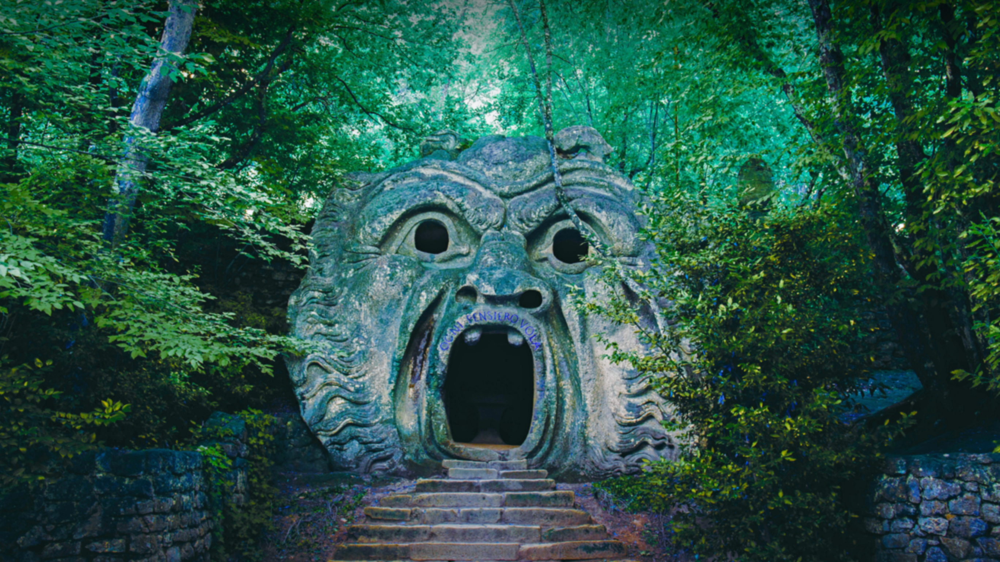

In [ ]:
!curl -o logo.png https://colab.research.google.com/img/colab_favicon_256px.png
import cv2
cv2_imshow(image)

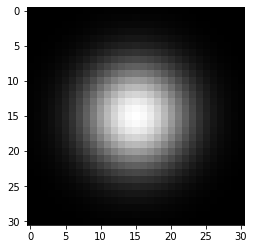

In [84]:
#gaussian filter:
sigma = 5   #res1: 6 , 0.05
k_box = 31  #at least : (2*)3*sigma + 1
mean = (k_box - 1) / 2
gaussian_filter = np.zeros((k_box, k_box),dtype = np.float32)

for i in range(k_box):
  for j in range(k_box):
    gaussian_filter[i, j] = np.exp(-((i - mean)**2 + (j - mean)**2)/(2 * sigma**2))
#normalizing the filter:
gaussian_filter = gaussian_filter/np.sum(gaussian_filter) 
kernel = gaussian_filter
plt.imshow(gaussian_filter, cmap='gray')

In [ ]:
#box filter:
k_box = 9
kernel = np.ones(shape=(k_box, k_box)) / (k_box**2)

In [85]:
def sharpening(image, kernel, a, name_smooth, name_mask, name_sharp):
  image_smooth = cv2.filter2D(src=image, ddepth=-1, kernel=kernel).astype(np.uint8)
  #cv2.imwrite(name_smooth + '.jpg', image_smooth)
  unsharp_mask = image - image_smooth
  #cv2.imwrite(name_mask + '.jpg', unsharp_mask)
  sharpened_image = image + a*unsharp_mask
  sharpened_image[sharpened_image < 0] = 0
  sharpened_image[sharpened_image > 255] = 255
  sharpened_image = sharpened_image.astype(np.uint8)
  #cv2.imwrite(name_sharp + '.jpg', sharpened_image)
  return sharpened_image


In [90]:
im1 = sharpening(image, kernel, 0.05, 'res0', 'res1', 'res2')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4534  100  4534    0     0   102k      0 --:--:-- --:--:-- --:--:--  102k


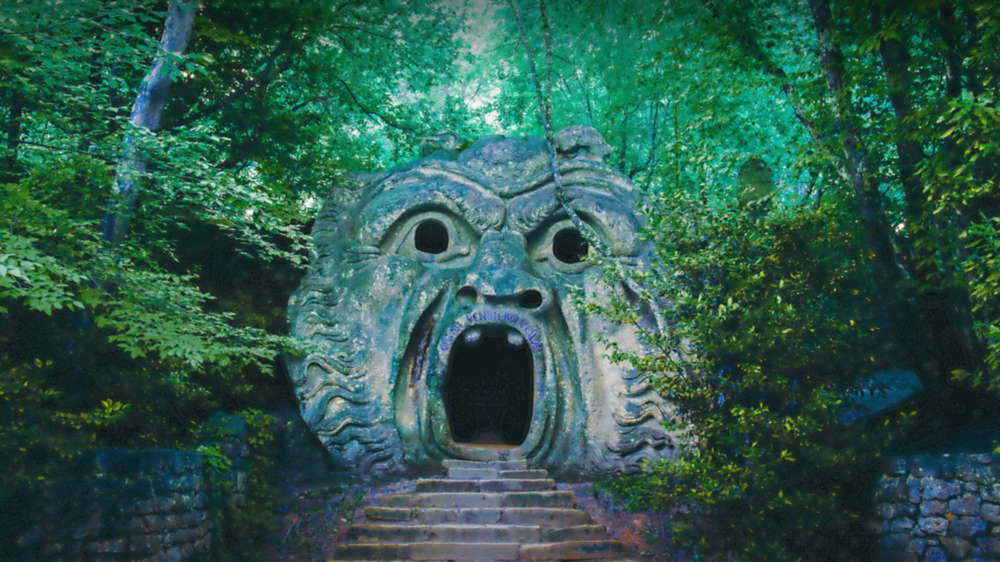

In [91]:
!curl -o logo.png https://colab.research.google.com/img/colab_favicon_256px.png
import cv2
cv2_imshow(im1)

In [ ]:
im2 = sharpening(image, kernel, 0.08, '1', '2', '3')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4534  100  4534    0     0  94458      0 --:--:-- --:--:-- --:--:-- 94458


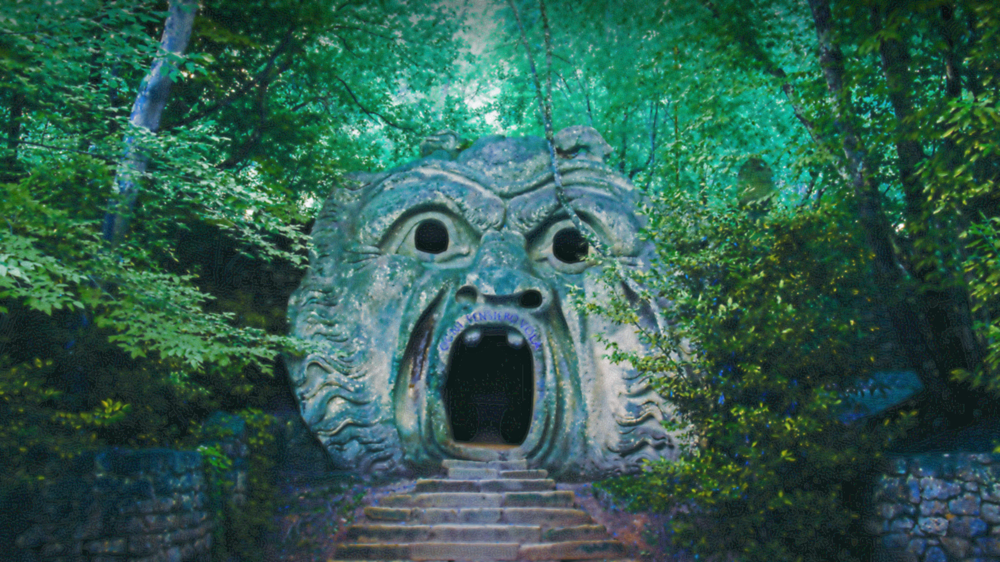

In [ ]:
!curl -o logo.png https://colab.research.google.com/img/colab_favicon_256px.png
import cv2
cv2_imshow(im2)

In [31]:
f = np.fft.fft2(image.astype(np.float32))
F_image = np.fft.fftshift(f)


In [63]:
s = np.fft.ifftshift(F_image[:, :, 0])
a = np.fft.ifft2(s)

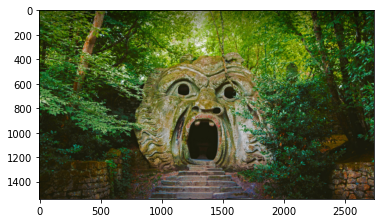

In [34]:
plt.imshow(np.abs(a).astype(np.uint8))

In [80]:
m, n, k = image.shape
H = np.zeros((m, n), dtype=np.float32)
D0 = 5
for u in range(m):
  for v in range(n):
    D = np.sqrt((u - m/2)**2 + (v - n/2)**2)
    H[u, v] = np.exp(-D**2 / (2*D0*D0))

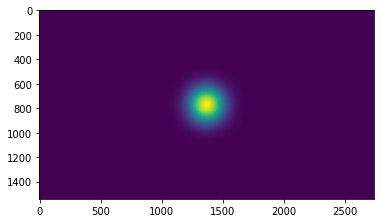

In [21]:
plt.imshow(H)

In [88]:
H_hp = 1 - H

#filtered = np.zeros((m, n, 3))
G = np.zeros((m, n, 3), dtype=np.complex_)
#im = np.zeros((m, n, 3))
for k in range(3):
  G[:, :, k] = ((1 + 0.2*H_hp) * F_image[:, :, k])
  #G[:, :, k] = H_hp * F_image[:, :, k]

I_shift = np.fft.ifftshift(G)
filtered = np.abs(np.fft.ifft2(I_shift)).astype(np.uint8)

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4534  100  4534    0     0  96468      0 --:--:-- --:--:-- --:--:-- 96468


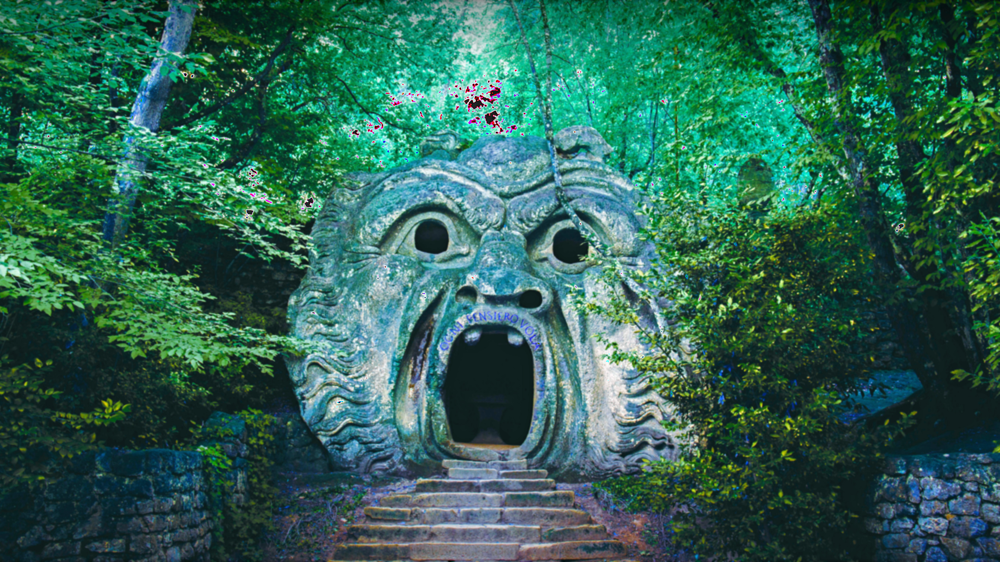

In [89]:
!curl -o logo.png https://colab.research.google.com/img/colab_favicon_256px.png
import cv2
cv2_imshow(filtered)

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4534  100  4534    0     0  50943      0 --:--:-- --:--:-- --:--:-- 50943


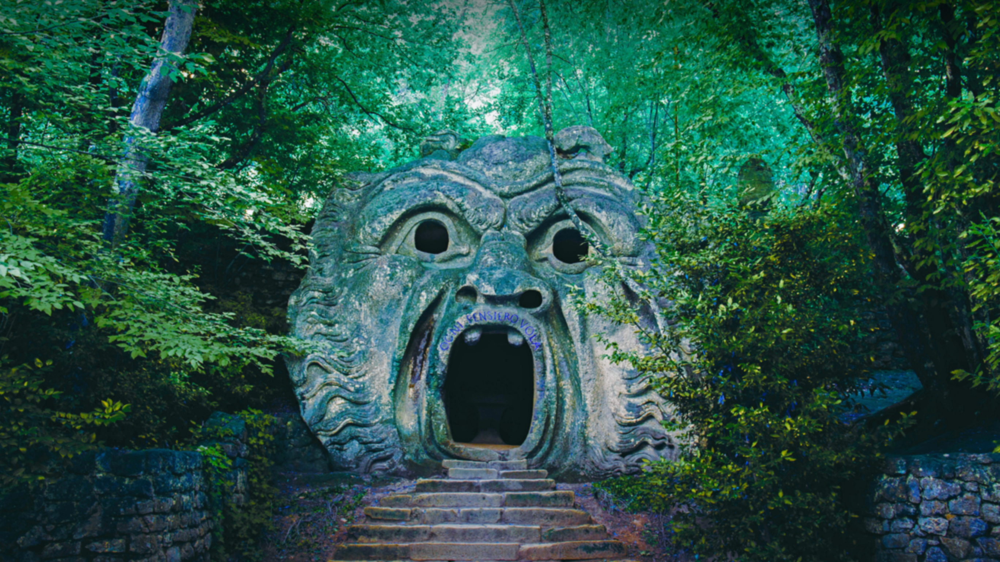

In [83]:
!curl -o logo.png https://colab.research.google.com/img/colab_favicon_256px.png
import cv2
cv2_imshow(image)